In [15]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline  

In [16]:
df=pd.read_csv("LondonAirbnbUpdated.csv")

## Price Column

In [17]:
df["price"]=df["price"].astype(float)

In [18]:
df = df[(df['price'] < 300)]

In [19]:
df["pricedist"]=np.nan
for i in range(len(df)):
    if df["price"].iloc[i]<=5:
      df["pricedist"].iloc[i]="Very Low Cost"
    elif df["price"].iloc[i]<=25 and df["price"].iloc[i]>5:
      df["pricedist"].iloc[i]="Low Cost"
    elif df["price"].iloc[i]<=45 and df["price"].iloc[i]>25:
      df["pricedist"].iloc[i]="Medium Cost"
    elif df["price"].iloc[i]<=70 and df["price"].iloc[i]>45:
      df["pricedist"].iloc[i]="High Cost"





C:\Users\2192a\anaconda3\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


# Geospatial Analysis

In [20]:
df

,Unnamed: 0,Unnamed: 0.1,neighbourhood_cleansed,latitude,longitude,room_type,accommodates,bathrooms_text,bedrooms,beds,price,maximum_nights,has_availability,review_scores_rating,calculated_host_listings_count,reviews_per_month,pricedist
0,0,0,Lambeth,51.460950,-0.117580,Entire home/apt,4,1 bath,1.0,3.0,99.0,1125,t,4.57,3,1.63,NaN
1,1,1,Islington,51.568610,-0.112700,Private room,2,1 shared bath,1.0,0.0,65.0,29,t,4.85,2,0.17,High Cost
2,2,2,Kensington and Chelsea,51.487800,-0.168130,Entire home/apt,2,1 bath,1.0,1.0,75.0,50,t,4.79,1,0.81,NaN
4,4,4,Hammersmith and Fulham,51.479350,-0.197430,Private room,2,1 private bath,1.0,1.0,150.0,21,t,NaN,2,NaN,NaN
5,5,5,Barnet,51.574380,-0.210810,Private room,2,1.5 shared baths,1.0,0.0,29.0,1120,t,4.78,3,0.98,Medium Cost
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
73359,73359,73359,Westminster,51.517627,-0.148625,Entire home/apt,6,2 baths,3.0,3.0,276.0,90,t,NaN,9,NaN,NaN
73360,73360,73360,Camden,51.540537,-0.194614,Entire home/apt,4,2 baths,2.0,2.0,117.0,30,t,NaN,5,NaN,NaN
73361,73361,73361,Hackney,51.554799,-0.073718,Entire home/apt,2,1 bath,1.0,0.0,48.0,10,t,NaN,2,NaN,High Cost
73362,73362,73362,Hackney,51.554562,-0.073245,Entire home/apt,2,1 bath,1.0,0.0,56.0,1125,t,NaN,2,NaN,High Cost


In [21]:
lat=df["latitude"].mean()
long=df["longitude"].mean()

In [22]:
import folium
from folium import Choropleth, Circle, Marker
from folium.plugins import HeatMap, MarkerCluster

In [163]:
import geopandas as gpd
data = gpd.read_file("/content/neighbourhoods.geojson")
data["neighbourhood"].unique()

array(['Kingston upon Thames', 'Croydon', 'Bromley', 'Hounslow', 'Ealing',
       'Havering', 'Hillingdon', 'Harrow', 'Brent', 'Barnet', 'Enfield',
       'Waltham Forest', 'Redbridge', 'Sutton', 'Lambeth', 'Southwark',
       'Lewisham', 'Greenwich', 'Bexley', 'Richmond upon Thames',
       'Merton', 'Wandsworth', 'Hammersmith and Fulham',
       'Kensington and Chelsea', 'City of London', 'Westminster',
       'Camden', 'Tower Hamlets', 'Islington', 'Hackney', 'Haringey',
       'Newham', 'Barking and Dagenham'], dtype=object)

London Map With Its Coordinates

In [164]:
hood = data.loc[data.neighbourhood.isin(['Kingston upon Thames', 'Croydon', 'Bromley', 'Hounslow', 'Ealing',
       'Havering', 'Hillingdon', 'Harrow', 'Brent', 'Barnet', 'Enfield',
       'Waltham Forest', 'Redbridge', 'Sutton', 'Lambeth', 'Southwark',
       'Lewisham', 'Greenwich', 'Bexley', 'Richmond upon Thames',
       'Merton', 'Wandsworth', 'Hammersmith and Fulham',
       'Kensington and Chelsea', 'City of London', 'Westminster',
       'Camden', 'Tower Hamlets', 'Islington', 'Hackney', 'Haringey',
       'Newham', 'Barking and Dagenham'])].copy()

London Through The Lens Of GeoPandas Library

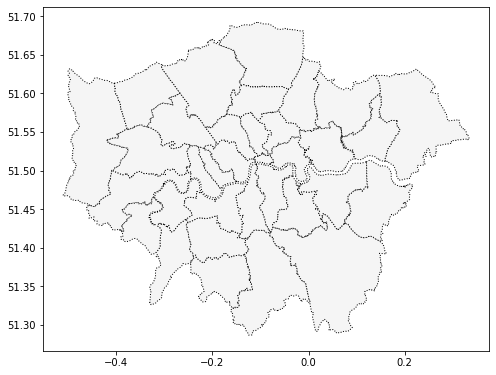

In [165]:
ax = hood.plot(figsize=(8,8), color='whitesmoke', linestyle=':', edgecolor='black')

Representation Of Airbnb Lodgings Using Matplotplib

<AxesSubplot:xlabel='longitude', ylabel='latitude'>

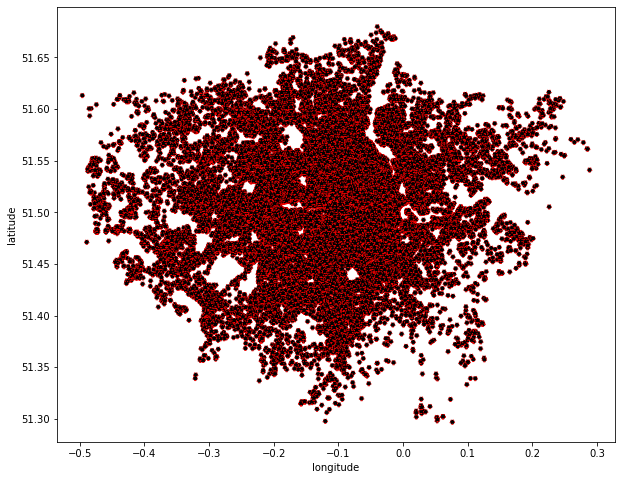

In [23]:
df.plot(kind="scatter",x="longitude",y="latitude",figsize=(10,8), color='black', linestyle=':', edgecolor='red')

Price Distribution Of Airbnb Lodgings

<AxesSubplot:xlabel='longitude', ylabel='latitude'>

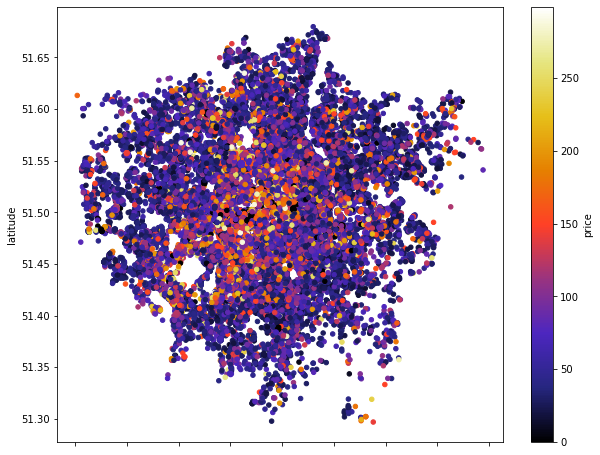

In [24]:
df.plot(kind="scatter",x="longitude",y="latitude",figsize=(10,8), cmap=plt.get_cmap("CMRmap"),c="price")

## Interactive Maps 

### London Interactive Map

In [27]:
mapp = folium.Map(location=[lat,long], tiles='openstreetmap', zoom_start=11)
mapp

Distribution Of All London Airbnbs

In [26]:
mapp = folium.Map(location=[lat,long], tiles='openstreetmap', zoom_start=10)
HeatMap(data=df[['latitude', 'longitude']], blur=25,radius=10).add_to(mapp)
mapp

### Distribution Of Expensive Lodgings In London Airbnb

In [28]:
mapp = folium.Map(location=[lat,long], tiles='openstreetmap', zoom_start=11)
for i in range(len(df)):
    if df["price"].iloc[i]>=295:
        Marker([df['latitude'].iloc[i], df['longitude'].iloc[i]]).add_to(mapp)
mapp

### BubbleMap Showcasing Distribution Of High Cost Airbnbs In London

In [29]:
mapp = folium.Map(location=[lat,long], tiles='cartodbpositron', zoom_start=11)
for i in range(len(df)):
    if df["price"].iloc[i]>=250:
        Circle(location=[df['latitude'].iloc[i],df['longitude'].iloc[i]],color="violet",radius=0.11).add_to(mapp)
mapp

### Bubble Map Showcasing Distribution Of Cheapest Airbnbs

In [30]:
mapp = folium.Map(location=[lat,long], tiles='cartodbpositron', zoom_start=11)
for i in range(len(df)):
    if df["price"].iloc[i]<5:
        Circle(location=[df['latitude'].iloc[i],df['longitude'].iloc[i]],color="black",radius=0.11).add_to(mapp)
mapp

Plotting Some Of London's Famous Tourist Attractions On The Interactive Map

In [172]:
from geopandas.tools import geocode
mapp = folium.Map(location=[lat,long], tiles='openstreetmap', zoom_start=12)
attractions=["Buckingham Palace","St. Paul's Cathedral","Westminster abbey","National History Museum","Hyde Park","Tower Bridge","London Eye","Big Ben","British Museum","Piccadilly Circus","The Shard"]

for i in attractions:
  x=geocode(i, provider="nominatim")
  point = x.geometry.iloc[0]
  Marker([point.y, point.x]).add_to(mapp)
mapp



/usr/local/lib/python3.7/dist-packages/geopy/geocoders/osm.py:143: UserWarning: Using Nominatim with the default "geopy/1.17.0" `user_agent` is strongly discouraged, as it violates Nominatim's ToS https://operations.osmfoundation.org/policies/nominatim/ and may possibly cause 403 and 429 HTTP errors. Please specify a custom `user_agent` with `Nominatim(user_agent="my-application")` or by overriding the default `user_agent`: `geopy.geocoders.options.default_user_agent = "my-application"`. In geopy 2.0 this will become an exception.
  UserWarning


Distribution Of Higher Priced Airbnb Lodgings With Respect To Tourist Locations

In [173]:
mapp = folium.Map(location=[lat,long], tiles='cartodbpositron', zoom_start=12)
attractions=["Buckingham Palace","St. Paul's Cathedral","Westminster abbey","National History Museum","Hyde Park","Tower Bridge","London Eye","Big Ben","British Museum","Piccadilly Circus","The Shard","Heathrow Airport"]

for i in attractions:
  x=geocode(i, provider="nominatim")
  point = x.geometry.iloc[0]
  Marker([point.y, point.x]).add_to(mapp)

for i in range(len(df)):
    if df["price"].iloc[i]>=250:
        Circle(location=[df['latitude'].iloc[i],df['longitude'].iloc[i]],color="red",radius=0.11).add_to(mapp)
mapp

/usr/local/lib/python3.7/dist-packages/geopy/geocoders/osm.py:143: UserWarning: Using Nominatim with the default "geopy/1.17.0" `user_agent` is strongly discouraged, as it violates Nominatim's ToS https://operations.osmfoundation.org/policies/nominatim/ and may possibly cause 403 and 429 HTTP errors. Please specify a custom `user_agent` with `Nominatim(user_agent="my-application")` or by overriding the default `user_agent`: `geopy.geocoders.options.default_user_agent = "my-application"`. In geopy 2.0 this will become an exception.
  UserWarning


## Distribution Of Airbnb Lodges Under 50 Euros, Based On Price

In [196]:
mapp = folium.Map(location=[lat,long], tiles='cartodbpositron', zoom_start=11)
for i in range(len(df)):
    if df["pricedist"].iloc[i]=="Very Low Cost":
        Circle(location=[df['latitude'].iloc[i],df['longitude'].iloc[i]],color="yellow",radius=0.11).add_to(mapp)
    if df["pricedist"].iloc[i]=="Low Cost":
        Circle(location=[df['latitude'].iloc[i],df['longitude'].iloc[i]],color="violet",radius=0.11).add_to(mapp)
    if df["pricedist"].iloc[i]=="Medium Cost":
        Circle(location=[df['latitude'].iloc[i],df['longitude'].iloc[i]],color="lightblue",radius=0.11).add_to(mapp)
mapp

## Listings With High Accomodating Capacities

In [198]:
mapp = folium.Map(location=[lat,long], tiles='cartodbpositron', zoom_start=11)
for i in range(len(df)):
    if df["accommodates"].iloc[i]>=8:
        Circle(location=[df['latitude'].iloc[i],df['longitude'].iloc[i]],color="yellow",radius=0.11).add_to(mapp)
mapp

### Taking The Posh Neighbourhood Of Westminster And Analysing Its Price Distribution

In [206]:
mapp = folium.Map(location=[lat,long], tiles='cartodbpositron', zoom_start=12)
for i in range(len(df)):
    if df["neighbourhood_cleansed"].iloc[i]=="Westminster" and df["pricedist"].iloc[i]=="Very Low Cost":
        Circle(location=[df['latitude'].iloc[i],df['longitude'].iloc[i]],color="yellow",radius=3).add_to(mapp)
    if df["neighbourhood_cleansed"].iloc[i]=="Westminster" and df["pricedist"].iloc[i]=="Low Cost":
        Circle(location=[df['latitude'].iloc[i],df['longitude'].iloc[i]],color="green",radius=3).add_to(mapp)
    if df["neighbourhood_cleansed"].iloc[i]=="Westminster" and df["pricedist"].iloc[i]=="Medium Cost":
        Circle(location=[df['latitude'].iloc[i],df['longitude'].iloc[i]],color="violet",radius=3).add_to(mapp)
mapp

### Distribution Of Owners With More Than 10 Listings, Making The Host An Effecient Businessperson

In [204]:
mapp = folium.Map(location=[lat,long], tiles='cartodbpositron', zoom_start=11)
for i in range(len(df)):
    if df["calculated_host_listings_count"].iloc[i]>=10:
        Circle(location=[df['latitude'].iloc[i],df['longitude'].iloc[i]],color="purple",radius=3).add_to(mapp)
mapp